In [15]:
pip install plotly

Note: you may need to restart the kernel to use updated packages.


In [16]:
import json
import plotly.express as px
import pandas as pd

In [17]:
# Function to calculate centroid of a polygon
def calculate_centroid(coords):
    x = [p[0] for p in coords]
    y = [p[1] for p in coords]
    centroid_x = sum(x) / len(coords)
    centroid_y = sum(y) / len(coords)
    return [centroid_y, centroid_x]

In [5]:
# Read the GeoJSON file
geojson_file_path = 'Resources/neighbourhoods.geojson'
with open(geojson_file_path) as f:
    data = geojson.load(f)
data

{"features": [{"geometry": {"coordinates": [[[[139.857803, 35.635799], [139.855301, 35.636868], [139.850296, 35.637665], [139.849899, 35.639267], [139.850494, 35.639999], [139.858398, 35.638134], [139.857895, 35.635864], [139.857803, 35.635799]]], [[[139.889999, 35.750801], [139.890396, 35.750401], [139.899796, 35.743732], [139.900101, 35.7356], [139.897095, 35.726665], [139.901398, 35.721466], [139.912109, 35.711266], [139.916107, 35.707733], [139.918701, 35.6978], [139.905899, 35.683731], [139.889099, 35.680599], [139.885803, 35.6768], [139.885895, 35.671131], [139.886597, 35.669868], [139.886993, 35.653866], [139.882095, 35.644001], [139.875504, 35.640533], [139.872894, 35.638535], [139.871796, 35.639332], [139.863495, 35.638401], [139.849701, 35.642666], [139.845215, 35.642979], [139.845215, 35.65062], [139.845505, 35.656666], [139.846497, 35.669868], [139.848206, 35.679066], [139.846207, 35.682064], [139.847397, 35.695465], [139.840195, 35.701065], [139.835205, 35.703133], [139.83

In [20]:
# Extract polygons and properties
features = data['features']
# Prepare data for Plotly
polygons = []
neighborhood_names = []
for feature in features:
    geometry_type = feature['geometry']['type']
    neighborhood = feature['properties'].get('neighbourhood', 'Unknown')
    
    if geometry_type == 'MultiPolygon':
        for polygon in feature['geometry']['coordinates']:
            # Flatten the polygon coordinates
            flat_polygon = []
            for coord in polygon[0]:
                flat_polygon.append(coord)
            
            polygons.append(flat_polygon)
            neighborhood_names.append(neighborhood)

# Convert to DataFrame for Plotly
df = pd.DataFrame({
    'polygon': polygons,
    'neighborhood': neighborhood_names
})

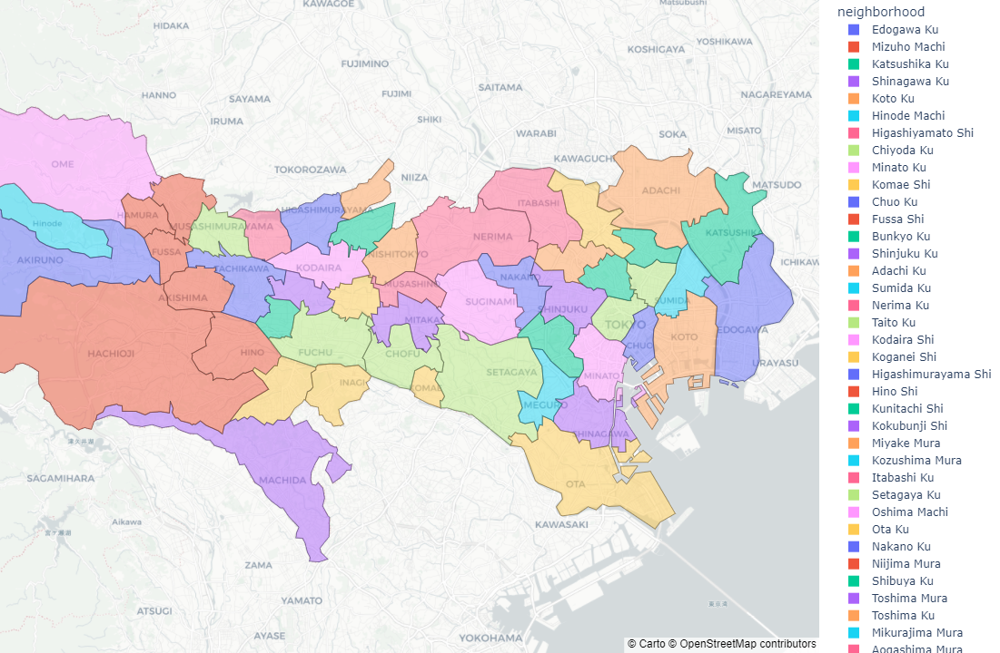

In [25]:
# Create Plotly figure
fig = px.choropleth_mapbox(
    df,
    geojson=data,
    locations='neighborhood',
    featureidkey="properties.neighbourhood",
    color='neighborhood',
    center={"lat": 35.6895, "lon": 139.6917},
    mapbox_style="carto-positron",
    zoom=10,
    opacity=0.5
)

fig.update_geos(fitbounds="locations", visible=True)
fig.update_layout(margin={"r":0,"t":0,"l":0,"b":0})

In [26]:
# Reading our CSV file and putting it into a variable
tokyo_airbnb = pd.read_csv("Resources/updated_summarylist.csv")
tokyo_airbnb.head()

,id,name,neighbourhood,latitude,longitude,host_id,host_name,room_type,price,minimum_nights,number_of_reviews,reviews_per_month,availability_365,ratings,bedrooms,beds,baths
0,197677,Rental unit in Sumida,Sumida Ku,35.71707,139.82608,964081,Yoshimi & Marek,Entire home/apt,11000,3,173,1.21,24,4.78,1.0,2.0,1.0
1,776070,Home in Kita-ku,Kita Ku,35.73844,139.76917,801494,Kei,Private room,7208,3,243,1.89,67,4.98,1.0,1.0,1.0
2,3427384,Rental unit in Edogawa,Edogawa Ku,35.68374,139.85971,13018876,Masakatsu,Entire home/apt,7847,2,100,0.93,231,4.82,1.0,2.0,1.0
3,905944,Rental unit in Shibuya,Shibuya Ku,35.67878,139.67847,4847803,Best Stay In Tokyo!,Entire home/apt,23066,3,186,1.49,229,4.76,2.0,4.0,1.0
4,3514008,Rental unit in Arakawa-ku,Arakawa Ku,35.72672,139.78201,17694529,Hisao,Entire home/apt,2871,1,269,2.59,11,4.86,1.0,2.0,1.0


In [27]:
for idx, row in tokyo_airbnb.iterrows():
    fig.add_scattermapbox(
        lat=[row['latitude']],
        lon=[row['longitude']],
        mode='markers',
        marker=dict(size=9, color='red'),
        text=f"Name: {row['name']}<br>Room Type: {row['room_type']}<br>Price: {row['price']}",
        hoverinfo='text'
    )

In [ ]:
fig.show()

In [31]:
fig.write_html('tokyo_neighorhoods.html')